

## 1. Importing Necessary Libraries

All the packages that are needed for the entire notebook.

In [77]:
% matplotlib inline
import lightgbm as lgb
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pandas_profiling as pp
import seaborn as sns
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from sklearn import metrics
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, f1_score, recall_score
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier

UsageError: Line magic function `%` not found.


## 2. Importing Dataset

In [ ]:
data = pd.read_csv(r'dataset_of_diabetes.csv')

# show the data of how many rows and columns
print("Data Shape - ", data.shape)
data.head(5)

## 3. Understanding the Data

In [ ]:
# description of the current data set
data.describe()

In [ ]:
data.describe(include=np.object).transpose()

In [ ]:
data['Gender'].value_counts(normalize=True)

Here is where we found that the dataset had some inconsistency in the dataset.

In [ ]:
data.Gender.unique()

In [ ]:
data.tail()

In [ ]:
# check out if the data has all the data
data.isnull().values.any()

In [ ]:
# to know the data type of the features
data.info()

In [ ]:
data['CLASS'].value_counts(normalize=True)

Here is where we found that there were inconsistency with class as well. The different classes are for non-diabetic, pre-diabetic and diabetic.

In [ ]:
data['Gender'] = data.apply(lambda row: 0 if row['Gender'] == 'M' else 1, axis=1)

In [ ]:
data['Gender'].value_counts(normalize=True)


Here we fixed the genders into numbers where Male is 0 and all others became one for female.

In [ ]:
data.CLASS.unique()

In [ ]:
# fix space in the data in CLASS column
def fix_class(row):
    if row['CLASS'] == 'N':
        return 0
    elif row['CLASS'] == 'P':
        return 1
    elif row['CLASS'] == 'Y':
        return 2
    elif row['CLASS'] == 'N ':
        return 0
    elif row['CLASS'] == 'Y ':
        return 2

In [ ]:
data['CLASS'] = data.apply(lambda row: fix_class(row), axis=1)
data.CLASS.unique()

After the fix-class method the different classes is 0 for non-diabetic and 1 for pre-diabetic and 2 for diabetic.

In [ ]:
data.head()

In [ ]:
data.tail()

# 4. Data Profiling Report

In [78]:
pp.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 5. EDA (Exploratory Data Analysis)

 ####     5.1   Drop out unnecessary column

In [79]:
data_new = data.drop(['ID', 'No_Pation'], axis=1)

### 5.2 Let's check if there are any null variables in the data_new dataset

In [80]:
data_new.isnull().sum()

Gender    0
AGE       0
Urea      0
Cr        0
HbA1c     0
Chol      0
TG        0
HDL       0
LDL       0
VLDL      0
BMI       0
CLASS     0
dtype: int64

# 6. Feature Engineering

### 6.1 Pearson correlation

Performing Pearson correlation analysis between attributes to aid in feature selection.

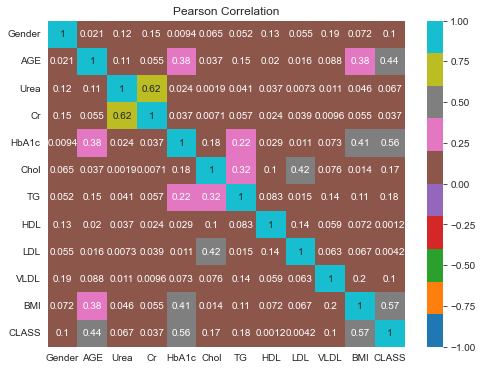

HDL       0.001248
LDL       0.004247
Cr        0.037500
Urea      0.067010
VLDL      0.101247
Gender    0.103397
Chol      0.167375
TG        0.182299
AGE       0.443009
HbA1c     0.555321
BMI       0.569879
CLASS     1.000000
Name: CLASS, dtype: float64


In [81]:
corr = data_new.corr(method='pearson').abs()

corr.describe()
corr.head()

fig = plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, cmap='tab10', vmin=-1, vmax=+1)
plt.title('Pearson Correlation')
plt.show()

print(data_new.corr()['CLASS'].abs().sort_values())


### 6.2 Univariate Selection using SelectKBest

Select features according to the k-highest scores.

In [82]:
#independent columns
X = data_new.iloc[:, 0:20]
#target column
y = data_new.iloc[:, -1]

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=10)
fit = bestfeatures.fit(X, y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

#concat two dataframes for better visualization
featurescores = pd.concat([dfcolumns, dfscores], axis=1)
#naming the dataframe columns
featurescores.columns = ['Specs', 'Score']
#print 10 best features
print(featurescores.nlargest(13, 'Score'))

     Specs       Score
1      AGE  319.999268
10     BMI  281.183581
4    HbA1c  241.741439
11   CLASS  228.557725
9     VLDL   80.330250
3       Cr   73.363497
6       TG   27.893108
0   Gender   10.283893
5     Chol    9.761831
2     Urea    9.272571
7      HDL    0.309676
8      LDL    0.294061


### 6.3 Feature Importance

[0.00677237 0.04278368 0.00530841 0.00588777 0.09195473 0.0114689
 0.01335724 0.00374419 0.00608975 0.00792288 0.09313612 0.71157395]


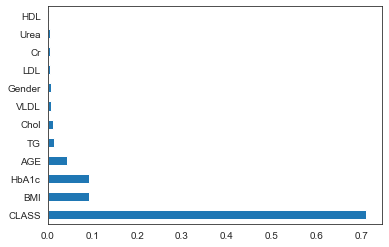

In [83]:
#independent columns
X = data_new.iloc[:, 0:20]
#target column
y = data_new.iloc[:, -1]

model = ExtraTreesClassifier()
model.fit(X, y)
print(model.feature_importances_)  #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(13).plot(kind='barh')
plt.show()

Importance here is of course CLASS to know if patient has diabetes or not. BMI and HbA1c and Age are important. Several resources online have tests and have placed rather heavy focus on BMI and Age and the data on hand indicate this as well. With higher BMI and Higher age the chance for type 2 diabetes increase. HbA1c is about the amount of glucose attached to the hemoglobin and is clearly a strong indicator as well for obvious reasons. 

### 6.4 Correlation Matrix with Heatmap

A graphical representation of a correlation matrix representing the correlation between different variables.
The value of correlation can take any value from -1 to 1.

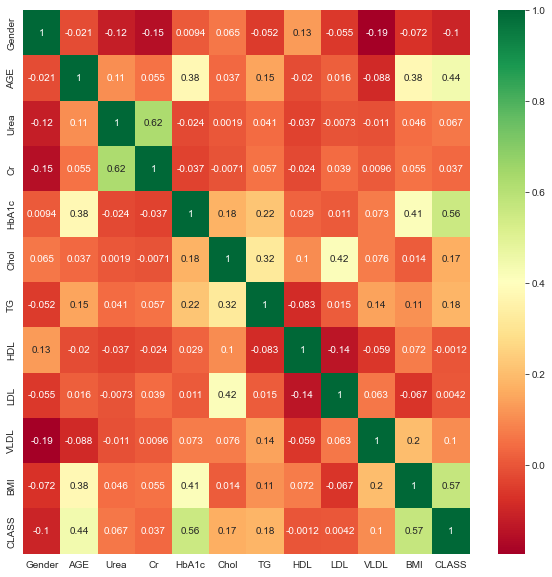

In [84]:
#independent columns
X = data_new.iloc[:, 0:20]
#target column
y = data_new.iloc[:, -1]

#get correlations of each features in dataset
corrmatrix = data_new.corr()
top_corr_features = corrmatrix.index
plt.figure(figsize=(10, 10))

#plot heat map
g = sns.heatmap(data_new[top_corr_features].corr(), annot=True, cmap="RdYlGn")

From the above correlation heatmap, we could get some of the following information:

- Variables such as Bmi & Age, HbA1c & Bmi, Chol & LDL and HbA1c & Age are having strong positive correlation.
- Variables such as VLVD & Gender, HDL & LDL, and Gender & cr are having strong negative correlations.
- There are several variables that have no correlation and whose correlation value is near 0.

# 7. Applying Different Models On Train & Test Data #only suggestion feel free to try out other models :)

### 7.1) GBM (Gradient Boosting)


#### 7.1.1) LightGBM

c:\languages\python\python390\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "


[30]	training's multi_logloss: 0.0703539	valid_0's multi_logloss: 0.222166
[60]	training's multi_logloss: 0.018232	valid_0's multi_logloss: 0.220639
[90]	training's multi_logloss: 0.00570271	valid_0's multi_logloss: 0.247343
              precision    recall  f1-score   support

           0       0.90      0.79      0.84        91
           1       0.35      0.27      0.30        49
           2       0.95      0.98      0.97       760

    accuracy                           0.92       900
   macro avg       0.73      0.68      0.70       900
weighted avg       0.91      0.92      0.92       900

Training accuracy 1.000000
Testing accuracy 0.922222
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.7033607243779768
the precision score is : 0.7342733538135837
the recall score is : 0.6789260238508358
LightGBM Accuracy: 0.922
-------------------------------------------------
Number of mislabeled points out of a total 900 points : 70


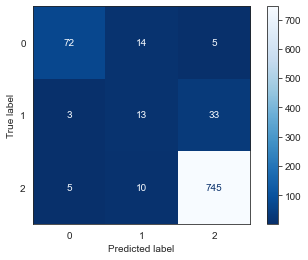

In [85]:
diabetes_lgb = data_new
diabetes_lgb.head()

# define input and output features to train model
X = diabetes_lgb.drop(['CLASS'], axis=1)
y = diabetes_lgb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.90, random_state=42)

model_lgb = lgb.LGBMClassifier(learning_rate=0.08, max_depth=-3, random_state=42)
model_lgb.fit(X_train, y_train, eval_set=[(X_test, y_test), (X_train, y_train)],
              verbose=30, eval_metric='logloss')

y_pred = model_lgb.predict(X_test)

# Save accuracy score for summary display in section 8
acc_lgb = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_lgb.predict(X_test)))
print("Training accuracy {:4f}".format(model_lgb.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_lgb.score(X_test, y_test)))
print("-------------------------------------------------")

#lgb.plot_importance(model_lgb)
#lgb.plot_metric(model_lgb)
metrics.plot_confusion_matrix(model_lgb, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("LightGBM Accuracy: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

# 7. Applying Different Models On Train & Test Data #only suggestion feel free to try out other models :)

### 7.1) GBM (Gradient Boosting)


              precision    recall  f1-score   support

           0       0.98      1.00      0.99        91
           1       1.00      1.00      1.00        49
           2       1.00      1.00      1.00       760

    accuracy                           1.00       900
   macro avg       0.99      1.00      1.00       900
weighted avg       1.00      1.00      1.00       900

Training accuracy 1.000000
Testing accuracy 0.997778
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.995937637241985
the precision score is : 0.992831541218638
the recall score is : 0.9991228070175439
GBM Accuracy is: 0.998
-------------------------------------------------
Number of mislabeled points out of a total 900 points : 2


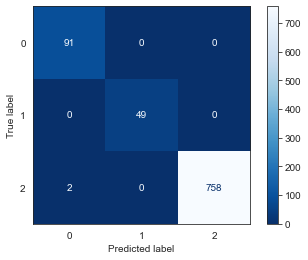

In [86]:
diabetes_gbm = data_new
diabetes_gbm.head()

# define input and output features to train model
X = diabetes_gbm.drop('CLASS', axis=1)
y = diabetes_gbm.CLASS

# train and test splitting
kf = KFold(n_splits=5, random_state=42, shuffle=True)

for train_index, val_index in kf.split(X):
    X_train, X_val = X.iloc[train_index], X.iloc[val_index]
    y_train, y_val = y.iloc[train_index], y.iloc[val_index]

model_gradient_booster = GradientBoostingClassifier(learning_rate=0.1)
model_gradient_booster.get_params()

model_gradient_booster.fit(X_train, y_train)

y_pred = model_gradient_booster.predict(X_test)

# Save accuracy score for summary display in section 8
acc_gbm = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_gradient_booster.predict(X_test)))
print("Training accuracy {:4f}".format(model_gradient_booster.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_gradient_booster.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_gradient_booster, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("GBM Accuracy is: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94        77
           1       0.90      0.95      0.93        40
           2       0.99      0.99      0.99       633

    accuracy                           0.98       750
   macro avg       0.95      0.95      0.95       750
weighted avg       0.98      0.98      0.98       750

Training accuracy 1.000000
Testing accuracy 0.980000
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.951795876515506
the precision score is : 0.950534355897132
the recall score is : 0.9536731567537254
GBM2 Accuracy is: 0.980
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 15


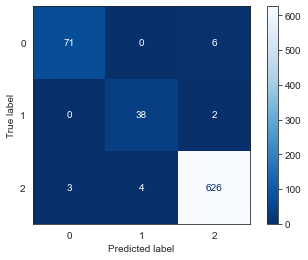

In [87]:
#anotherway of doing gbm
diabetes_gbm2 = data_new
diabetes_gbm2.head()

# define input and output features to train model
X = diabetes_gbm2.drop('CLASS', axis=1)
y = diabetes_gbm2.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())

model_GBMPipline = make_pipeline(preprocessor, GradientBoostingClassifier(learning_rate=0.1))
model_GBMPipline.fit(X_train, y_train)

y_proba = model_GBMPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

# Save accuracy score for summary display in section 8
acc_gbm2 = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_GBMPipline.predict(X_test)))
print("Training accuracy {:4f}".format(model_GBMPipline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_GBMPipline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_GBMPipline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("GBM2 Accuracy is: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

In [88]:
diabetes_lgbm = data_new
diabetes_lgbm.head()

# define input and output features to train model
X = diabetes_lgbm.drop('CLASS', axis=1)
y = diabetes_lgbm.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())

model_LightGBMPipeline = make_pipeline(preprocessor, LGBMClassifier(learning_rate=0.08, max_depth=-3, random_state=42))
model_LightGBMPipeline.fit(X_train, y_train)

y_proba = model_LightGBMPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

print(metrics.classification_report(y_test, model_LightGBMPipeline.predict(X_test)))
print("Training accuracy {:4f}".format(model_LightGBMPipeline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_LightGBMPipeline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_LightGBMPipeline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("LightGBM Accuracy: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

              precision    recall  f1-score   support

           0       0.96      0.96      0.96        82
           1       1.00      0.86      0.92        43
           2       0.99      1.00      0.99       675

    accuracy                           0.98       800
   macro avg       0.98      0.94      0.96       800
weighted avg       0.99      0.98      0.98       800

Training accuracy 1.000000
Testing accuracy 0.985000
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.9598550255414059
the precision score is : 0.9833995917051682
the recall score is : 0.9398117686603222
XGBoost Accuracy is:  0.985
-------------------------------------------------
Number of mislabeled points out of a total 800 points : 12


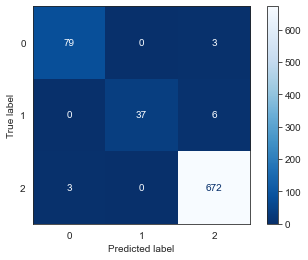

In [89]:
diabetes_xgb = data_new
diabetes_xgb.head()

# define input and output features to train model
X = diabetes_xgb.drop('CLASS', axis=1)
y = diabetes_xgb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.80, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
model_XGBPipline = make_pipeline(preprocessor, XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
                                                             colsample_bynode=1, colsample_bytree=1, gamma=0,
                                                             learning_rate=0.1,
                                                             max_delta_step=0, max_depth=3, min_child_weight=1,
                                                             missing=1,
                                                             n_estimators=100, n_jobs=1, nthread=None,
                                                             objective='multi:softprob', random_state=0, reg_alpha=0,
                                                             reg_lambda=1, scale_pos_weight=None, seed=None,
                                                             silent=None,
                                                             subsample=1, verbosity=1))

model_XGBPipline.fit(X_train, y_train)

y_proba = model_XGBPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

# Save accuracy score for summary display in section 8
acc_xgboost = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_XGBPipline.predict(X_test)))
print("Training accuracy {:4f}".format(model_XGBPipline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_XGBPipline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_XGBPipline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("XGBoost Accuracy is:  %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

In [90]:
diabetes_gbm = data_new
diabetes_gbm.head()

# define input and output features to train model
X = diabetes_gbm.drop('CLASS', axis=1)
y = diabetes_gbm.CLASS

# train and test splitting
kf = KFold(n_splits=5, random_state=42, shuffle=True)

for train_index, val_index in kf.split(X):
    X_train, X_val = X.iloc[train_index], X.iloc[val_index]
    y_train, y_val = y.iloc[train_index], y.iloc[val_index]

model_gradient_booster = GradientBoostingClassifier(learning_rate=0.1)
model_gradient_booster.get_params()

model_gradient_booster.fit(X_train, y_train)

y_pred = model_gradient_booster.predict(X_test)

print(metrics.classification_report(y_test, model_gradient_booster.predict(X_test)))
print("Training accuracy {:4f}".format(model_gradient_booster.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_gradient_booster.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_gradient_booster, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("GBM Accuracy is: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

0:	learn: 0.7749422	total: 36.7ms	remaining: 36.7s
1:	learn: 0.4996760	total: 64.7ms	remaining: 32.3s
2:	learn: 0.3461693	total: 92.4ms	remaining: 30.7s
3:	learn: 0.2463637	total: 132ms	remaining: 32.8s
4:	learn: 0.1774079	total: 145ms	remaining: 28.8s
5:	learn: 0.1353639	total: 174ms	remaining: 28.9s
6:	learn: 0.1009567	total: 204ms	remaining: 28.9s
7:	learn: 0.0766700	total: 231ms	remaining: 28.7s
8:	learn: 0.0590087	total: 260ms	remaining: 28.6s
9:	learn: 0.0465521	total: 290ms	remaining: 28.7s
10:	learn: 0.0377937	total: 319ms	remaining: 28.7s
11:	learn: 0.0322825	total: 347ms	remaining: 28.6s
12:	learn: 0.0270211	total: 379ms	remaining: 28.7s
13:	learn: 0.0234827	total: 410ms	remaining: 28.8s
14:	learn: 0.0202445	total: 447ms	remaining: 29.3s
15:	learn: 0.0180700	total: 493ms	remaining: 30.3s
16:	learn: 0.0158127	total: 560ms	remaining: 32.4s
17:	learn: 0.0134566	total: 596ms	remaining: 32.5s
18:	learn: 0.0119131	total: 672ms	remaining: 34.7s
19:	learn: 0.0106588	total: 743ms	rema

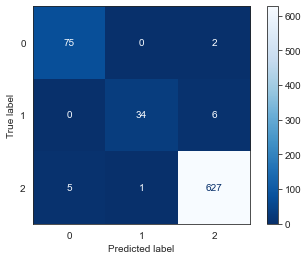

In [91]:
diabetes_catb = data_new
diabetes_catb.head()

# define input and output features to train model
X = diabetes_catb.drop('CLASS', axis=1)
y = diabetes_catb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
model_CatPipeline = make_pipeline(preprocessor, CatBoostClassifier(iterations=1000, loss_function='MultiClass',
                                                                   bootstrap_type="Bayesian",
                                                                   eval_metric='MultiClass',
                                                                   leaf_estimation_iterations=100,
                                                                   random_strength=0.5,
                                                                   depth=7,
                                                                   l2_leaf_reg=5,
                                                                   learning_rate=0.1,
                                                                   bagging_temperature=0.5,
                                                                   allow_writing_files=False))
model_CatPipeline.fit(X_train, y_train)

y_proba = model_CatPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

# Save accuracy score for summary display in section 8
acc_catboost = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_CatPipeline.predict(X_test)))
print("Training accuracy {:4f}".format(model_CatPipeline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_CatPipeline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_CatPipeline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("CatBoost Accuracy is :  %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

#### 7.1.3) XGBoost

              precision    recall  f1-score   support

           0       0.94      0.87      0.91        77
           1       0.85      0.70      0.77        40
           2       0.97      0.99      0.98       633

    accuracy                           0.96       750
   macro avg       0.92      0.85      0.88       750
weighted avg       0.96      0.96      0.96       750

Training accuracy 1.000000
Testing accuracy 0.958667
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.8827636691282305
the precision score is : 0.9193636975872183
the recall score is : 0.8519706202170657
Adaboost Accuracy is : 0.959
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 31


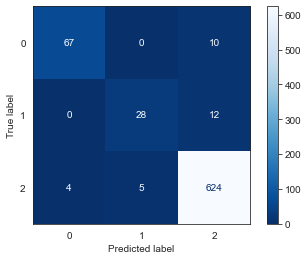

In [92]:
diabetes_adab = data_new
diabetes_adab.head()

# define input and output features to train model
X = diabetes_adab.drop('CLASS', axis=1)
y = diabetes_adab.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
model_AdaPipeline = make_pipeline(preprocessor, AdaBoostClassifier(n_estimators=200, learning_rate=1.4))

model_AdaPipeline.fit(X_train, y_train)

y_proba = model_AdaPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

# Save accuracy score for summary display in section 8
acc_adaboost = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_AdaPipeline.predict(X_test)))
print("Training accuracy {:4f}".format(model_AdaPipeline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_AdaPipeline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_AdaPipeline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Adaboost Accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

#### 7.1.4) CatBoost

c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        77
           1       0.00      0.00      0.00        40
           2       0.84      0.98      0.91       633

    accuracy                           0.83       750
   macro avg       0.28      0.33      0.30       750
weighted avg       0.71      0.83      0.77       750

Training accuracy 0.840000
Testing accuracy 0.830667
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.6921349785857919
the precision score is : 0.7340628429236024
the recall score is : 0.6738902224684216
Logistic Regression Accuracy is : 0.921
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 59


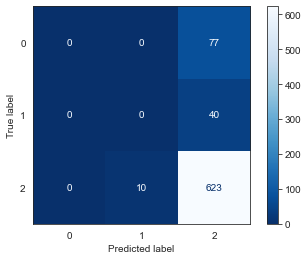

In [93]:
diabetes_lr = data_new
diabetes_lr.head()

# define input and output features to train model
X = diabetes_lr.drop('CLASS', axis=1)
y = diabetes_lr.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

# Create an instance of LogisticRegression classifier
model_lr = LogisticRegression(C=100.0, random_state=1, solver='lbfgs', multi_class='ovr')

# Fit the model
model_lr.fit(X_train_std, y_train)

# Create the predictions
y_pred = model_lr.predict(X_test_std)

# Save accuracy score for summary display in section 8
acc_logreg = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_lr.predict(X_test)))
print("Training accuracy {:4f}".format(model_lr.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_lr.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_lr, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Logistic Regression Accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

#### 7.1.5) AdaBoost

              precision    recall  f1-score   support

           0       0.95      0.91      0.93        77
           1       0.97      0.78      0.86        40
           2       0.98      0.99      0.98       633

    accuracy                           0.97       750
   macro avg       0.96      0.89      0.92       750
weighted avg       0.97      0.97      0.97       750

Training accuracy 1.000000
Testing accuracy 0.972000
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.9239395455031753
the precision score is : 0.9632837418163506
the recall score is : 0.892064004978697
Random Forest Accuracy is : 0.972
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 21


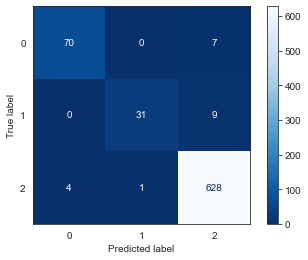

In [94]:
diabetes_rf = data_new
diabetes_rf.head()

# define input and output features to train model
X = diabetes_rf.drop(['CLASS'], axis=1)
y = diabetes_rf.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

model_rf = RandomForestClassifier()
model_rf.fit(X_train, y_train)

y_pred = model_rf.predict(X_test)

# Save accuracy score for summary display in section 8
acc_randomforest = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_rf.predict(X_test)))
print("Training accuracy {:4f}".format(model_rf.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_rf.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_rf, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Random Forest Accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

### 7.2) Logistic Regression


              precision    recall  f1-score   support

           0       0.66      0.81      0.73        74
           1       0.28      0.20      0.23        40
           2       0.96      0.95      0.96       636

    accuracy                           0.90       750
   macro avg       0.63      0.65      0.64       750
weighted avg       0.90      0.90      0.90       750

Training accuracy 0.936000
Testing accuracy 0.898667
-------------------------------------------------
the f1 score for Support Vector machine is : 0.6388342522692408
the precision score is : 0.6323691634036462
the recall score is : 0.6545469998300187
KNN accuracy is : 0.899
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 76


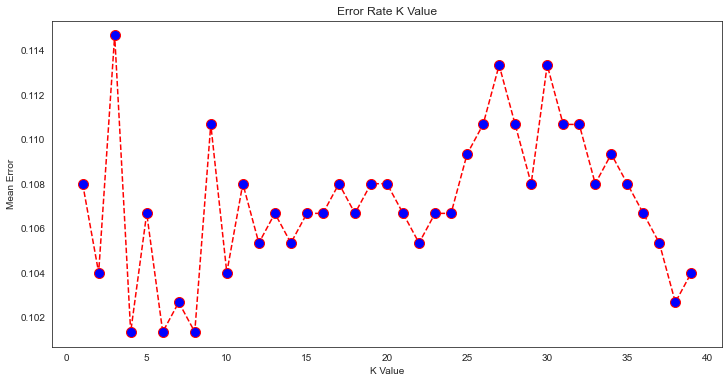

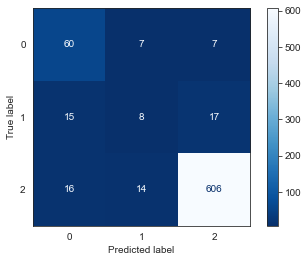

In [95]:
diabetes_knn = data_new
diabetes_knn.head()

# define input and output features to train model
X = diabetes_knn.drop(['CLASS', 'Gender', 'VLDL'], axis=1)
y = diabetes_knn.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75)

scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

model_knn = KNeighborsClassifier(n_neighbors=8)
model_knn.fit(X_train, y_train)

y_pred = model_knn.predict(X_test)

# Save accuracy score for summary display in section 8
acc_knn = metrics.accuracy_score(y_test, y_pred)

error = []

# Calculating error for K values between 1 and 40
for i in range(1, 40):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error.append(np.mean(pred_i != y_test))

plt.figure(figsize=(12, 6))
plt.plot(range(1, 40), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate K Value')
plt.xlabel('K Value')
plt.ylabel('Mean Error')

print(metrics.classification_report(y_test, model_knn.predict(X_test)))
print("Training accuracy {:4f}".format(model_knn.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_knn.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_knn, X_test, y_test, cmap='Blues_r')

print("the f1 score for Support Vector machine is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("KNN accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

### 7.3) Random Forest Classifier


c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.20      0.10      0.13        91
           1       0.00      0.00      0.00        49
           2       0.85      0.96      0.90       760

    accuracy                           0.82       900
   macro avg       0.35      0.35      0.34       900
weighted avg       0.74      0.82      0.77       900

Training accuracy 0.890000
Testing accuracy 0.816667
-------------------------------------------------
the f1 score for Support Vector machine is : 0.3436717047006576
the precision score is : 0.3485897566439263
the recall score is : 0.35138808559861195
Support Vector machine accuracy is : 0.817
-------------------------------------------------
Number of mislabeled points out of a total 900 points : 165


c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


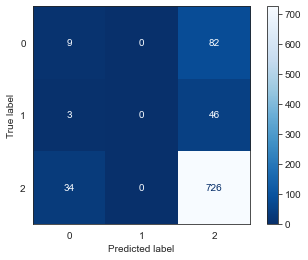

In [96]:
diabetes_svm = data_new
diabetes_svm.head()

# define input and output features to train model
X = diabetes_svm.drop(['CLASS', 'Gender', 'VLDL'], axis=1)
y = diabetes_svm.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.90, random_state=42)

model_SVM = SVC(random_state=0, probability=True, C=80.0, gamma=0.00002, kernel='rbf')
model_SVM.fit(X_train, y_train)

y_pred = model_SVM.predict(X_test)

# Save accuracy score for summary display in section 8
acc_svm = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_SVM.predict(X_test)))
print("Training accuracy {:4f}".format(model_SVM.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_SVM.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_SVM, X_test, y_test, cmap='Blues_r')

print("the f1 score for Support Vector machine is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Support Vector machine accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

## 7.4 KNN

              precision    recall  f1-score   support

           0       0.92      1.00      0.96        22
           1       1.00      1.00      1.00        10
           2       1.00      0.99      1.00       218

    accuracy                           0.99       250
   macro avg       0.97      1.00      0.98       250
weighted avg       0.99      0.99      0.99       250

Training accuracy 1.000000
Testing accuracy 0.992000
-------------------------------------------------
the f1 score for Decision tress is : 0.9839711480665198
the precision score is : 0.9722222222222222
the recall score is : 0.9969418960244649
Support Decision Tree accuracy is : 0.992
-------------------------------------------------
Number of mislabeled points out of a total 250 points : 2


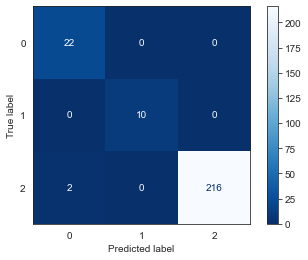

In [97]:
diabetes_dt = data_new
diabetes_dt.head()

# define input and output features to train model
X = diabetes_dt.drop('CLASS', axis=1)
y = diabetes_dt.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

model_dt = DecisionTreeClassifier(random_state=42)
model_dt.fit(X_train, y_train)

#path = model_dt.cost_complexity_pruning_path(X_train, y_train)

y_pred = model_dt.predict(X_test)

# Save accuracy score for summary display in section 8
acc_dt = metrics.accuracy_score(y_test, y_pred)

#ccp_alphas, impurities = path.ccp_alphas, path.impurities

'''fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")'''

print(metrics.classification_report(y_test, model_dt.predict(X_test)))
print("Training accuracy {:4f}".format(model_dt.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_dt.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_dt, X_test, y_test, cmap='Blues_r')

print("the f1 score for Decision tress is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Support Decision Tree accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

## 7.5 Support Vector Machine

              precision    recall  f1-score   support

           0       0.61      0.81      0.70        78
           1       0.78      0.64      0.71        45
           2       0.97      0.94      0.96       627

    accuracy                           0.91       750
   macro avg       0.79      0.80      0.79       750
weighted avg       0.92      0.91      0.91       750

Training accuracy 0.952000
Testing accuracy 0.910667
-------------------------------------------------
the f1 score for Naive Bayes is : 0.7863290869338838
the precision score is : 0.7880955760790235
the recall score is : 0.7982401613980562
Support Naive Bayes accuracy is : 0.911
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 67


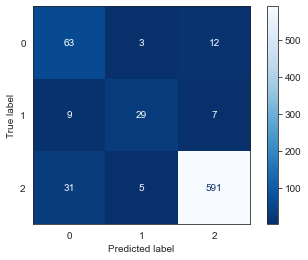

In [98]:
diabetes_nb = data_new
diabetes_nb.head()

# define input and output features to train model
X = diabetes_nb.drop('CLASS', axis=1)
y = diabetes_nb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42)

model_gnb = GaussianNB()
y_pred = model_gnb.fit(X_train, y_train).predict(X_test)

# Save accuracy score for summary display in section 8
acc_nb = metrics.accuracy_score(y_test, y_pred)

print(metrics.classification_report(y_test, model_gnb.predict(X_test)))
print("Training accuracy {:4f}".format(model_gnb.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_gnb.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_gnb, X_test, y_test, cmap='Blues_r')

print("the f1 score for Naive Bayes is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Support Naive Bayes accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

## 7.6 Decision tree

In [100]:
models = pd.DataFrame({
    'Model': ['Support Vector Machines', 'KNN', 'Logistic Regression',
              'Random Forest', 'Decision Tree', 'LightGBM', 'GBM', 'GBM2', 'AdaBoost',
              'XGBoost', 'CatBoost', 'Naive Bayes'],
    'Score': [acc_svm, acc_knn, acc_logreg, acc_randomforest, acc_dt, acc_lgb,
              acc_gbm, acc_gbm2, acc_adaboost, acc_xgboost, acc_catboost, acc_nb]})
models.sort_values(by='Score', ascending=False)

,Model,Score
6,GBM,0.997778
4,Decision Tree,0.992000
9,XGBoost,0.985000
10,CatBoost,0.981333
7,GBM2,0.980000
3,Random Forest,0.972000
8,AdaBoost,0.958667
5,LightGBM,0.922222
2,Logistic Regression,0.921333
11,Naive Bayes,0.910667


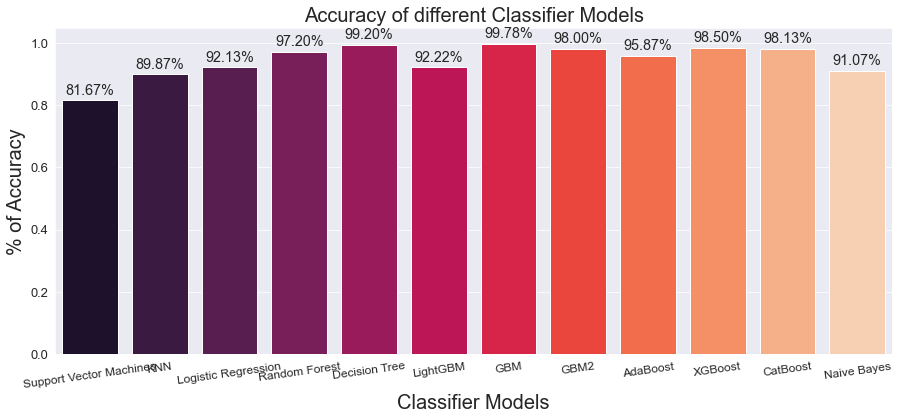

In [101]:
plt.rcParams['figure.figsize'] = 15, 6
sns.set_style("darkgrid")
ax = sns.barplot(x=models.Model, y=models.Score, palette="rocket", saturation=1.5)
plt.xlabel("Classifier Models", fontsize=20)
plt.ylabel("% of Accuracy", fontsize=20)
plt.title("Accuracy of different Classifier Models", fontsize=20)
plt.xticks(fontsize=12, horizontalalignment='center', rotation=8)
plt.yticks(fontsize=13)
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate(f'{height:.2%}', (x + width / 2, y + height * 1.02), ha='center', fontsize='x-large')
plt.show()

#### Interpretations and Recommendations

Overall, the model with the best performance was GBM, which used Kfold validation technique  to classify the test dataset with an accuracy of 98.78%. Decision Tree, XGBoost, CatBoost,
and GBM2 were tied with 99.29%, 98.50%, 98.13% and 98% accuracy respectively. However, all of the models also need and can be improved with  hyperparameter tuning, but that is beyond the scope of this project.

## 7.7 Naive Bayes

              precision    recall  f1-score   support

           0       0.61      0.81      0.70        78
           1       0.78      0.64      0.71        45
           2       0.97      0.94      0.96       627

    accuracy                           0.91       750
   macro avg       0.79      0.80      0.79       750
weighted avg       0.92      0.91      0.91       750

Training accuracy 0.952000
Testing accuracy 0.910667
-------------------------------------------------
the f1 score for Naive Bayes is : 0.7863290869338838
the precision score is : 0.7880955760790235
the recall score is : 0.7982401613980562
Support Naive Bayes accuracy is : 0.911
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 67


/home/emcy/.local/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


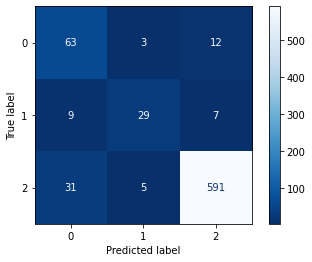

In [36]:
diabetes_nb = data_new
diabetes_nb.head()

# define input and output features to train model
X = diabetes_nb.drop('CLASS', axis=1)
y = diabetes_nb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42)

model_gnb = GaussianNB()
y_pred = model_gnb.fit(X_train, y_train).predict(X_test)

print(metrics.classification_report(y_test, model_gnb.predict(X_test)))
print("Training accuracy {:4f}".format(model_gnb.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_gnb.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_gnb, X_test, y_test, cmap='Blues_r')

print("the f1 score for Naive Bayes is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Support Naive Bayes accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

# 8. Displaying Best Model

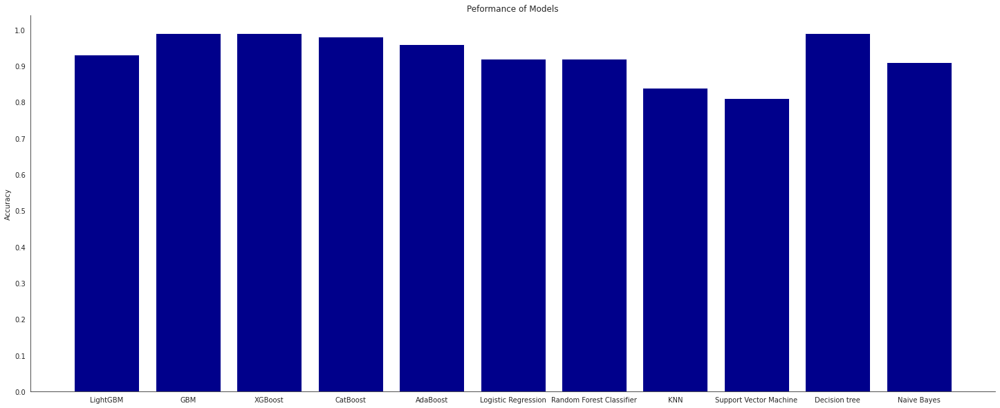

In [37]:
# Plot accuracies of supervised-machine learning models
best_scores = {'LightGBM': .93,
               'GBM': .99,
               'XGBoost': .99,
               'CatBoost': .98,
               'AdaBoost': .96,
               'Logistic Regression': .92,
               'Random Forest Classifier': .92,
               'KNN': .84,
               'Support Vector Machine': .81,
               'Decision tree': .99,
               'Naive Bayes': .91}

sns.set_style('white')
plt.figure(figsize=(25, 10))
plt.bar(best_scores.keys(), best_scores.values(), color='darkblue')
plt.yticks(ticks=np.linspace(0, 1.0, 11))
plt.ylabel('Accuracy')
plt.title('Peformance of Models')
sns.despine()
plt.show();